In [1]:
pip install ekonlpy

Note: you may need to restart the kernel to use updated packages.


In [1]:
import pandas as pd

# 뉴스기사, 채권보고서, 금통위 의사록 병합한 데이터프레임 형성
df=pd.read_csv('all_data_df.csv', index_col='Unnamed: 0')
df

,Unnamed: 0,date,title,content
0,0,2008-04-01,대우증권 월간 채권투자 4월,ㅎㅎㅎ2008_04 월간채권투자채 권 시 장 전 망금 융 시 장 차 트 북對應과 ...
1,1,2008-04-07,돌아온 박스권,Microsoft Word - 0407.docFixed Income Weekly 2...
2,2,2008-04-07,시간차 공격,Microsoft Word - 0407.docFixed Income Weekly 2...
3,3,2008-04-14,총재의 변신은 무죄다,Microsoft Word - Fixedincome0414.doc 4월 금통위...
4,4,2008-04-21,항상 열려는 있는 가능성,Microsoft Word - 920_0421_Fixed Income Weekly....
...,...,...,...,...
8140,8140,2024-03-31,"중위소득이 살 수 있는 서울 아파트, 100채중 6채 불과",서울 주택구입물량지수 6.4전국선 경북 91.6 가장 높아\n\n\n\n개포동 디에...
8141,8141,2024-03-31,내일부터 중견·중소 대상 11조원 은행권 지원프로그램 개시,저리 대출프로그램 6조·이자경감 5조[이데일리 송주오 기자] 내일(4월 1일)부터 ...
8142,8142,2024-03-31,‘대어급’ SK하이닉스…최대 7500억 회사채 조달,"[회사채프리뷰]SK하이닉스, 1년여 만에 공모채 시장 복귀상반기 7500억 규모 회..."
8143,8143,2024-04-12,금융통화위원회 의사록(2024년도 제7차)(2024.4.12),['일부 위원은 소비자물가 상승률에 대한 식료품의 기여도가 미국이나 유로지역에서는 ...


# 토큰화 + 엔그램 생성

In [40]:
from ekonlpy.sentiment import MPCK
from tqdm import tqdm

mpck = MPCK()
pos_tag = ['NNG', 'NNP', 'VA', 'VV+ETM', 'MAG', 'VV', 'XPN']
df['tokens_ngrams'] = None
for idx, row in tqdm(df.iterrows()):
  text = df['content'][idx]
  tokens = mpck.tokenize(text)
  tokens_list = []
  for token in tokens:
      if token.split('/')[1] in pos_tag:
        if len(token.split('/')[0]) >1 :
          tokens_list.append(token)
  ngrams = mpck.ngramize(tokens)
  tokens_ngrams = tokens_list + ngrams
  df['tokens_ngrams'][idx] = ','.join(tokens_ngrams)

8145it [18:01,  7.53it/s]


In [41]:
df.head()

,date,title,content,tokens_ngrams
0,2008-04-01,대우증권 월간 채권투자 4월,ㅎㅎㅎ2008_04 월간채권투자채 권 시 장 전 망금 융 시 장 차 트 북對應과 ...,"권투/NNG,자채/NNG,시장/NNG,전망/NNG,금융시장/NNG,對應/NNG,限界..."
1,2008-04-07,돌아온 박스권,Microsoft Word - 0407.docFixed Income Weekly 2...,"돌아온/VV,박스권/NNG,하단/NNG,상단/NNG,테스트/NNG,가능성/NNG,무..."
2,2008-04-07,시간차 공격,Microsoft Word - 0407.docFixed Income Weekly 2...,"돌아온/VV,박스권/NNG,하단/NNG,상단/NNG,테스트/NNG,가능성/NNG,무..."
3,2008-04-14,총재의 변신은 무죄다,Microsoft Word - Fixedincome0414.doc 4월 금통위...,"믹스/NNG,합의/NNG,반영/NNG,예상/NNG,경제/NNG,성장률/NNG,하향/..."
4,2008-04-21,항상 열려는 있는 가능성,Microsoft Word - 920_0421_Fixed Income Weekly....,"경기/NNG,전망/NNG,분명/MAG,인플레이션/NNG,명분/NNG,결정/NNG,금..."


# call rate 기준 labeling

In [43]:
date_range = pd.date_range(start='2008-03-01', end='2024-06-01', freq='D')
call_final_df=pd.DataFrame(date_range, columns=['날짜'])
call_final_df

,날짜
0,2008-03-01
1,2008-03-02
2,2008-03-03
3,2008-03-04
4,2008-03-05
...,...
5932,2024-05-28
5933,2024-05-29
5934,2024-05-30
5935,2024-05-31


In [6]:
call_all_df = pd.read_csv('crawling/call_rate.csv', index_col='Unnamed: 0')
call_all_df.reset_index(drop=True, inplace=True)
call_all_df.head()

,날짜,종가,한달 전 날짜
0,2024-06-17,3.50,2024-05-17
1,2024-06-14,3.50,2024-05-14
2,2024-06-13,3.53,2024-05-13
3,2024-06-12,3.55,2024-05-12
4,2024-06-11,3.59,2024-05-11


In [52]:
merged_df = pd.merge(call_final_df, call_all_df, on='날짜', how='outer')
merged_df = merged_df.sort_values(by='날짜')
merged_df.reset_index(drop=True, inplace=True)
merged_df['종가'] = merged_df['종가'].fillna(method='ffill')
merged_df

C:\Users\duwjd\AppData\Local\Temp\ipykernel_14268\352792634.py:4: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  merged_df['종가'] = merged_df['종가'].fillna(method='ffill')


,날짜,종가,한달 전 날짜
0,2008-02-27,4.94,2008-01-27
1,2008-02-28,4.96,2008-01-28
2,2008-02-29,4.94,2008-01-29
3,2008-03-01,4.94,NaN
4,2008-03-02,4.94,NaN
...,...,...,...
5949,2024-06-11,3.59,2024-05-11
5950,2024-06-12,3.55,2024-05-12
5951,2024-06-13,3.53,2024-05-13
5952,2024-06-14,3.50,2024-05-14


In [53]:
now_list = []
for i in range(len(df)):
    date_value = df.iloc[i, 0]
    if not merged_df[merged_df['날짜'] == date_value].empty:
        now = merged_df.loc[merged_df['날짜'] == date_value].iloc[0, 1]
        now_list.append(now)
    else:
        now_list.append(None)  # 데이터가 없는 경우 처리

# df의 '현재 종가' 열에 now_list를 설정합니다.
df['현재 종가'] = now_list

past_date_list = []
for i in range(len(df)):
    date_value = df.iloc[i, 0]
    if not merged_df[merged_df['날짜'] == date_value].empty:
        past_date = merged_df.loc[merged_df['날짜'] == date_value].iloc[0, 2]
        past_date_list.append(past_date)
    else:
        past_date_list.append(None)  # 데이터가 없는 경우 처리

df['past date'] = past_date_list

In [54]:
df = df.sort_values(by='date')
df.reset_index(drop=True, inplace=True)
df

,date,title,content,tokens_ngrams,현재 종가,past date
0,2008-04-01,대우증권 월간 채권투자 4월,ㅎㅎㅎ2008_04 월간채권투자채 권 시 장 전 망금 융 시 장 차 트 북對應과 ...,"권투/NNG,자채/NNG,시장/NNG,전망/NNG,금융시장/NNG,對應/NNG,限界...",4.97,2008-03-01
1,2008-04-07,돌아온 박스권,Microsoft Word - 0407.docFixed Income Weekly 2...,"돌아온/VV,박스권/NNG,하단/NNG,상단/NNG,테스트/NNG,가능성/NNG,무...",5.04,2008-03-07
2,2008-04-07,시간차 공격,Microsoft Word - 0407.docFixed Income Weekly 2...,"돌아온/VV,박스권/NNG,하단/NNG,상단/NNG,테스트/NNG,가능성/NNG,무...",5.04,2008-03-07
3,2008-04-14,총재의 변신은 무죄다,Microsoft Word - Fixedincome0414.doc 4월 금통위...,"믹스/NNG,합의/NNG,반영/NNG,예상/NNG,경제/NNG,성장률/NNG,하향/...",5.00,2008-03-14
4,2008-04-21,항상 열려는 있는 가능성,Microsoft Word - 920_0421_Fixed Income Weekly....,"경기/NNG,전망/NNG,분명/MAG,인플레이션/NNG,명분/NNG,결정/NNG,금...",4.97,2008-03-21
...,...,...,...,...,...,...
8140,2024-03-31,내일부터 중견·중소 대상 11조원 은행권 지원프로그램 개시,저리 대출프로그램 6조·이자경감 5조[이데일리 송주오 기자] 내일(4월 1일)부터 ...,"저리/MAG,대출/NNG,프로그램/NNG,이자/NNG,경감/NNG,송주/NNG,기자...",3.57,NaN
8141,2024-03-31,너무 뜨거운 고용시장…금리인하 불씨 꺼트리나,[사진출처 = 연합뉴스]내달 1일부터 중소·중견기업을 위한 11조원 규모의 금융지원...,"출처/NNG,중소/NNG,중견/NNG,기업/NNG,위하/VV,규모/NNG,금융지원/...",3.57,NaN
8142,2024-03-31,‘대어급’ SK하이닉스…최대 7500억 회사채 조달,"[회사채프리뷰]SK하이닉스, 1년여 만에 공모채 시장 복귀상반기 7500억 규모 회...","회사채/NNG,프리뷰/NNG,공모채/NNG,시장/NNG,복귀/NNG,규모/NNG,회...",3.57,NaN
8143,2024-04-12,금융통화위원회 의사록(2024년도 제7차)(2024.4.12),['일부 위원은 소비자물가 상승률에 대한 식료품의 기여도가 미국이나 유로지역에서는 ...,"소비자/NNG,물가/NNG,상승률/NNG,식료품/NNG,기여도/NNG,유로존/NNG...",3.50,2024-03-12


In [55]:
past_list = []
for i in range(len(df)):
    date_value = df.iloc[i, 5]
    if not merged_df[merged_df['날짜'] == date_value].empty:
        past = merged_df.loc[merged_df['날짜'] == date_value].iloc[0, 1]
        past_list.append(past)
    else:
        past_list.append(None)  # 데이터가 없는 경우 처리

df['과거 종가']=past_list
df

,date,title,content,tokens_ngrams,현재 종가,past date,과거 종가
0,2008-04-01,대우증권 월간 채권투자 4월,ㅎㅎㅎ2008_04 월간채권투자채 권 시 장 전 망금 융 시 장 차 트 북對應과 ...,"권투/NNG,자채/NNG,시장/NNG,전망/NNG,금융시장/NNG,對應/NNG,限界...",4.97,2008-03-01,4.94
1,2008-04-07,돌아온 박스권,Microsoft Word - 0407.docFixed Income Weekly 2...,"돌아온/VV,박스권/NNG,하단/NNG,상단/NNG,테스트/NNG,가능성/NNG,무...",5.04,2008-03-07,5.00
2,2008-04-07,시간차 공격,Microsoft Word - 0407.docFixed Income Weekly 2...,"돌아온/VV,박스권/NNG,하단/NNG,상단/NNG,테스트/NNG,가능성/NNG,무...",5.04,2008-03-07,5.00
3,2008-04-14,총재의 변신은 무죄다,Microsoft Word - Fixedincome0414.doc 4월 금통위...,"믹스/NNG,합의/NNG,반영/NNG,예상/NNG,경제/NNG,성장률/NNG,하향/...",5.00,2008-03-14,4.98
4,2008-04-21,항상 열려는 있는 가능성,Microsoft Word - 920_0421_Fixed Income Weekly....,"경기/NNG,전망/NNG,분명/MAG,인플레이션/NNG,명분/NNG,결정/NNG,금...",4.97,2008-03-21,4.98
...,...,...,...,...,...,...,...
8140,2024-03-31,내일부터 중견·중소 대상 11조원 은행권 지원프로그램 개시,저리 대출프로그램 6조·이자경감 5조[이데일리 송주오 기자] 내일(4월 1일)부터 ...,"저리/MAG,대출/NNG,프로그램/NNG,이자/NNG,경감/NNG,송주/NNG,기자...",3.57,NaN,NaN
8141,2024-03-31,너무 뜨거운 고용시장…금리인하 불씨 꺼트리나,[사진출처 = 연합뉴스]내달 1일부터 중소·중견기업을 위한 11조원 규모의 금융지원...,"출처/NNG,중소/NNG,중견/NNG,기업/NNG,위하/VV,규모/NNG,금융지원/...",3.57,NaN,NaN
8142,2024-03-31,‘대어급’ SK하이닉스…최대 7500억 회사채 조달,"[회사채프리뷰]SK하이닉스, 1년여 만에 공모채 시장 복귀상반기 7500억 규모 회...","회사채/NNG,프리뷰/NNG,공모채/NNG,시장/NNG,복귀/NNG,규모/NNG,회...",3.57,NaN,NaN
8143,2024-04-12,금융통화위원회 의사록(2024년도 제7차)(2024.4.12),['일부 위원은 소비자물가 상승률에 대한 식료품의 기여도가 미국이나 유로지역에서는 ...,"소비자/NNG,물가/NNG,상승률/NNG,식료품/NNG,기여도/NNG,유로존/NNG...",3.50,2024-03-12,3.42


In [56]:
df['종가 변화']=df['현재 종가']-df['과거 종가']

In [57]:
for i in range(len(df['종가 변화'])):
    if df.iloc[i,7]>0:
        df.iloc[i,7]='up'
    elif df.iloc[i,7]<0:
        df.iloc[i,7]='down'
    else:
        df.iloc[i,7]='middle'

df=df.dropna()
df

C:\Users\duwjd\AppData\Local\Temp\ipykernel_14268\2222925862.py:3: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value 'up' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  df.iloc[i,7]='up'


,date,title,content,tokens_ngrams,현재 종가,past date,과거 종가,종가 변화
0,2008-04-01,대우증권 월간 채권투자 4월,ㅎㅎㅎ2008_04 월간채권투자채 권 시 장 전 망금 융 시 장 차 트 북對應과 ...,"권투/NNG,자채/NNG,시장/NNG,전망/NNG,금융시장/NNG,對應/NNG,限界...",4.97,2008-03-01,4.94,up
1,2008-04-07,돌아온 박스권,Microsoft Word - 0407.docFixed Income Weekly 2...,"돌아온/VV,박스권/NNG,하단/NNG,상단/NNG,테스트/NNG,가능성/NNG,무...",5.04,2008-03-07,5.00,up
2,2008-04-07,시간차 공격,Microsoft Word - 0407.docFixed Income Weekly 2...,"돌아온/VV,박스권/NNG,하단/NNG,상단/NNG,테스트/NNG,가능성/NNG,무...",5.04,2008-03-07,5.00,up
3,2008-04-14,총재의 변신은 무죄다,Microsoft Word - Fixedincome0414.doc 4월 금통위...,"믹스/NNG,합의/NNG,반영/NNG,예상/NNG,경제/NNG,성장률/NNG,하향/...",5.00,2008-03-14,4.98,up
4,2008-04-21,항상 열려는 있는 가능성,Microsoft Word - 920_0421_Fixed Income Weekly....,"경기/NNG,전망/NNG,분명/MAG,인플레이션/NNG,명분/NNG,결정/NNG,금...",4.97,2008-03-21,4.98,down
...,...,...,...,...,...,...,...,...
8113,2024-03-29,이조특위 띄운 與…‘부동산 사기대출 의혹’ 양문석 고발키로,"신지호 이조특위 위원장, 중앙당사 기자회견“특경법에 따라 3년 이상 유기징역 가능 ...","특위/NNG,중앙/NNG,특경/NNG,유기/NNG,징역/NNG,가능/NNG,사안/N...",3.57,2024-02-29,3.46,up
8114,2024-03-29,한국은행 작년 순이익 1.3조…16년 만에 최소 실적,한국은행 2023년도 연차보고서 발간전년比 1.1조↓…2007년 이후 최저 순이익유...,"연차보고서/NNG,발간/NNG,최저/NNG,익유/NNG,증권/NNG,매매차익/NNG...",3.57,2024-02-29,3.46,up
8115,2024-03-29,글로벌 M&A 시장 '기지개'…올해 1분기 거래액 30% 증가,"글로벌 M&A, 거래건수 31% 줄었지만 거래액은 30%↑100억달러 이상 대규모 ...","글로벌/NNG,m&a/NNG,거래/NNG,건수/NNG,거래액/NNG,달러/NNG,대...",3.57,2024-02-29,3.46,up
8143,2024-04-12,금융통화위원회 의사록(2024년도 제7차)(2024.4.12),['일부 위원은 소비자물가 상승률에 대한 식료품의 기여도가 미국이나 유로지역에서는 ...,"소비자/NNG,물가/NNG,상승률/NNG,식료품/NNG,기여도/NNG,유로존/NNG...",3.50,2024-03-12,3.42,up


# 사전 만들기

In [58]:
#유니크한 word set 만들기
words = []
for idx, row in df.iterrows():
  words += row['tokens_ngrams'].split(',')

words = list(set(words))

In [59]:
df_dic = pd.DataFrame(words, columns=['words'])
df_dic.set_index('words', inplace=True)

In [60]:
df_dic

""
words
""
고용/NNG;비용/NNG;상승/NNG
미/NNG;고용/NNG;지표/NNG;호전/NNG
지표/NNG;개선/NNG;경계/NNG
외국인/NNG;국채선물/NNG;매도/NNG;부담/NNG
...
가격/NNG;유가/NNG;하락/NNG
가조/NNG
제조업/NNG;상승/NNG


up, down count 세기

In [61]:
df_up = df[df['종가 변화']=='up']
df_down = df[df['종가 변화']=='down']

words_up=[]
for idx, row in df_up.iterrows():
  words_up += row['tokens_ngrams'].split(',')

df_up = pd.DataFrame(words_up, columns=['words'])
df_up = pd.DataFrame(df_up['words'].value_counts())

In [62]:
words_down=[]
for idx, row in df_down.iterrows():
  words_down += row['tokens_ngrams'].split(',')

df_down = pd.DataFrame(words_down, columns=['words'])
df_down = pd.DataFrame(df_down['words'].value_counts())

up, down 사전 만들기

In [63]:
# df_dic, df_up
df_dictionary = pd.merge(df_dic, df_up, left_index=True, right_index=True, how='left')
df_dictionary = df_dictionary.rename(columns={'count':'count_up'})
df_dictionary = df_dictionary.fillna(0)
# df_dic, df_down
df_dictionary = pd.merge(df_dictionary, df_down, left_index=True, right_index=True, how='left')
df_dictionary = df_dictionary.rename(columns={'count':'count_down'})
df_dictionary = df_dictionary.fillna(0)

In [64]:
df_dictionary['total'] = None
for idx, row in df_dictionary.iterrows():
  df_dictionary['total'][idx] = row['count_up'] + row['count_down']

C:\Users\duwjd\AppData\Local\Temp\ipykernel_14268\684037327.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dictionary['total'][idx] = row['count_up'] + row['count_down']
C:\Users\duwjd\AppData\Local\Temp\ipykernel_14268\684037327.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dictionary['total'][idx] = row['count_up'] + row['count_down']
C:\Users\duwjd\AppData\Local\Temp\ipykernel_14268\684037327.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#retu

In [65]:
#15회 미만인 ngram 제거
df_dictionary = df_dictionary[df_dictionary['total'] >=15]
df_dictionary

,count_up,count_down,total
words,,,
중개/NNG,50.0,55.0,105.0
여력/NNG;제한적/VAX,12.0,16.0,28.0
채택/NNG,45.0,67.0,112.0
금리/NNG;인상/NNG;지연/NNG,26.0,33.0,59.0
증감액/NNG,19.0,41.0,60.0
...,...,...,...
노하우/NNG,13.0,21.0,34.0
소비/NNG;심리/NNG;회복/NNG,7.0,11.0,18.0
자본비율/NNG,221.0,194.0,415.0


In [66]:
#laplace smoothing
df_dictionary['count_down'] = df_dictionary['count_down'] +1
df_dictionary['count_up'] = df_dictionary['count_up'] +1
df_dictionary['total'] = df_dictionary['total'] +2

C:\Users\duwjd\AppData\Local\Temp\ipykernel_14268\3970776246.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dictionary['count_down'] = df_dictionary['count_down'] +1
C:\Users\duwjd\AppData\Local\Temp\ipykernel_14268\3970776246.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dictionary['count_up'] = df_dictionary['count_up'] +1
C:\Users\duwjd\AppData\Local\Temp\ipykernel_14268\3970776246.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using

In [67]:
df_dictionary

,count_up,count_down,total
words,,,
중개/NNG,51.0,56.0,107.0
여력/NNG;제한적/VAX,13.0,17.0,30.0
채택/NNG,46.0,68.0,114.0
금리/NNG;인상/NNG;지연/NNG,27.0,34.0,61.0
증감액/NNG,20.0,42.0,62.0
...,...,...,...
노하우/NNG,14.0,22.0,36.0
소비/NNG;심리/NNG;회복/NNG,8.0,12.0,20.0
자본비율/NNG,222.0,195.0,417.0


polarity score 계산하기

In [68]:
ptotal = df_dictionary['count_up'].sum()
ntotal = df_dictionary['count_down'].sum()


polarity_score_list = []
for i in range(0,len(df_dictionary)):
  polarity_score = (df_dictionary['count_up'][i]/ ptotal) / (df_dictionary['count_down'][i]/ ntotal)
  polarity_score_list.append(polarity_score)

df_dictionary.loc[:, 'polarity_score'] = polarity_score_list
df_dictionary

C:\Users\duwjd\AppData\Local\Temp\ipykernel_14268\240025348.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  polarity_score = (df_dictionary['count_up'][i]/ ptotal) / (df_dictionary['count_down'][i]/ ntotal)
C:\Users\duwjd\AppData\Local\Temp\ipykernel_14268\240025348.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dictionary.loc[:, 'polarity_score'] = polarity_score_list


,count_up,count_down,total,polarity_score
words,,,,
중개/NNG,51.0,56.0,107.0,1.261165
여력/NNG;제한적/VAX,13.0,17.0,30.0,1.058971
채택/NNG,46.0,68.0,114.0,0.936782
금리/NNG;인상/NNG;지연/NNG,27.0,34.0,61.0,1.099701
증감액/NNG,20.0,42.0,62.0,0.659433
...,...,...,...,...
노하우/NNG,14.0,22.0,36.0,0.881242
소비/NNG;심리/NNG;회복/NNG,8.0,12.0,20.0,0.923206
자본비율/NNG,222.0,195.0,417.0,1.576551


In [107]:
#임계치 적용
intensity_threshold = 1.3

hawkish_dictionary = df_dictionary[df_dictionary.polarity_score >= intensity_threshold]
hawkish_dictionary = list(hawkish_dictionary.index)

dovish_dictionary = df_dictionary[df_dictionary.polarity_score <= 1/intensity_threshold]
dovish_dictionary = list(dovish_dictionary.index)

### 사전 완성


In [95]:
# 사전 확인
hawkish_dictionary.to_csv('hawkish_list.csv', encoding='utf-8')
dovish_dictionary.to_csv('dovish_list.csv', encoding='utf-8')

# 금융통화위원회 의사록 톤 구하기

In [76]:
minutes=pd.read_csv('minutes_test.csv')
minutes.head()

,Unnamed: 0,date,title,content
0,0,2024-05-23,금융통화위원회 의사록(2024년도 제10차)(2024.5.23),"['일부 위원은 OPEC 결속력 약화, 미국의 원유 생산능력 증가 등을 고려하면국제..."
1,2,2024-04-12,금융통화위원회 의사록(2024년도 제7차)(2024.4.12),['일부 위원은 소비자물가 상승률에 대한 식료품의 기여도가 미국이나 유로지역에서는 ...
2,5,2024-02-22,금융통화위원회 의사록(2024년도 제4차)(2024.2.22),['일부 위원은 최근 농산물가격이 예년보다 높은 상승률을 지속하고 있는 배경에 대해...
3,11,2023-11-30,금융통화위원회 의사록(2023년도 제22차)(2023.11.30),['일부 위원은 관련 부서가 금년 중 외국인직접투자(inbound)의 상당폭 증가가...
4,15,2023-08-24,금융통화위원회 의사록(2023년도 제16차)(2023.8.24),['일부 위원은 최근 중국과 더불어 우리나라와 아세안 국가들의 수출이 큰 폭으로 감...


In [77]:
#의사록을 문장단위로 나누기
minutes['split_content'] = None
for idx,row in minutes.iterrows():
  tmp = minutes['content'][idx].split("', '")
  minutes['split_content'][idx] = tmp

C:\Users\duwjd\AppData\Local\Temp\ipykernel_14268\3179055476.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  minutes['split_content'][idx] = tmp
C:\Users\duwjd\AppData\Local\Temp\ipykernel_14268\3179055476.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  minutes['split_content'][idx] = tmp
C:\Users\duwjd\AppData\Local\Temp\ipykernel_14268\3179055476.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  minutes['split_content'][idx

In [78]:
minutes

,Unnamed: 0,date,title,content,split_content
0,0,2024-05-23,금융통화위원회 의사록(2024년도 제10차)(2024.5.23),"['일부 위원은 OPEC 결속력 약화, 미국의 원유 생산능력 증가 등을 고려하면국제...","[['일부 위원은 OPEC 결속력 약화, 미국의 원유 생산능력 증가 등을 고려하면국..."
1,2,2024-04-12,금융통화위원회 의사록(2024년도 제7차)(2024.4.12),['일부 위원은 소비자물가 상승률에 대한 식료품의 기여도가 미국이나 유로지역에서는 ...,[['일부 위원은 소비자물가 상승률에 대한 식료품의 기여도가 미국이나 유로지역에서는...
2,5,2024-02-22,금융통화위원회 의사록(2024년도 제4차)(2024.2.22),['일부 위원은 최근 농산물가격이 예년보다 높은 상승률을 지속하고 있는 배경에 대해...,[['일부 위원은 최근 농산물가격이 예년보다 높은 상승률을 지속하고 있는 배경에 대...
3,11,2023-11-30,금융통화위원회 의사록(2023년도 제22차)(2023.11.30),['일부 위원은 관련 부서가 금년 중 외국인직접투자(inbound)의 상당폭 증가가...,[['일부 위원은 관련 부서가 금년 중 외국인직접투자(inbound)의 상당폭 증가...
4,15,2023-08-24,금융통화위원회 의사록(2023년도 제16차)(2023.8.24),['일부 위원은 최근 중국과 더불어 우리나라와 아세안 국가들의 수출이 큰 폭으로 감...,[['일부 위원은 최근 중국과 더불어 우리나라와 아세안 국가들의 수출이 큰 폭으로 ...
...,...,...,...,...,...
86,194,2014-07-10,금융통화위원회 의사록(2014년도 제13차)(2014.7.10.),['일부 위원은 세계경제나 우리경제가 한 번도경험하지 못한 불확실성에 처해 있기 때...,[['일부 위원은 세계경제나 우리경제가 한 번도경험하지 못한 불확실성에 처해 있기 ...
87,195,2014-06-12,금융통화위원회 의사록(2014년도 제11차)(2014.6.12.),['일부 위원은 금년 2월 이후 경기동행지수 및경기선행지수의 순환변동치를 보면 경기...,[['일부 위원은 금년 2월 이후 경기동행지수 및경기선행지수의 순환변동치를 보면 경...
88,196,2014-05-09,금융통화위원회 의사록(2014년도 제9차)(2014.5.9.),['일부 위원은 경제상황이 지난달과 대체로 비슷한 모습이나 세월호 사고 여파로 인해...,[['일부 위원은 경제상황이 지난달과 대체로 비슷한 모습이나 세월호 사고 여파로 인...
89,198,2014-04-10,금융통화위원회 의사록(2014년도 제7차)(2014.4.10.),['일부 위원은 국민계정의 새로운 국제기준(2008SNA) 이행으로 지식재산생산물(...,[['일부 위원은 국민계정의 새로운 국제기준(2008SNA) 이행으로 지식재산생산물...


In [79]:
# 문장을 token화 및 ngram화한 뒤, 회의록df에 열 생성

from tqdm import tqdm

minutes['ngrams'] = None

for i in tqdm(range(len(minutes['split_content']))):
  sentence_list=[]
  sentence = minutes['split_content'][i]
  for j in sentence:
    if len(j)>1:
      tmp_tokens = mpck.tokenize(j)
      for tmp in tmp_tokens:
        tokens_list=[]
        if tmp.split('/')[1] in ['NNG', 'NNP', 'VA', 'VV+ETM', 'MAG', 'VV', 'XPN']:
          tokens_list.append(tmp)
      tmp_ngrams = mpck.ngramize(tmp_tokens)
      ngram = tokens_list + tmp_ngrams
      sentence_list.append(ngram)
  minutes['ngrams'][i]=sentence_list

  0%|                                                                                           | 0/91 [00:00<?, ?it/s]C:\Users\duwjd\AppData\Local\Temp\ipykernel_14268\3619896598.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  minutes['ngrams'][i]=sentence_list
  1%|▉                                                                                  | 1/91 [00:00<01:14,  1.21it/s]C:\Users\duwjd\AppData\Local\Temp\ipykernel_14268\3619896598.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  minutes['ngrams'][i]=sentence_list
  2%|█▊                                                                                 | 

문장별 tone 구하기

In [135]:
minutes

,Unnamed: 0,date,title,content,split_content,ngrams,tone_sentence,tone_doc
0,0,2024-05-23,금융통화위원회 의사록(2024년도 제10차)(2024.5.23),"['일부 위원은 OPEC 결속력 약화, 미국의 원유 생산능력 증가 등을 고려하면국제...","[['일부 위원은 OPEC 결속력 약화, 미국의 원유 생산능력 증가 등을 고려하면국...","[[나타나/VV, 물가/NNG;압력/NNG;우려/NNG, 생산능력/NNG;증가/NN...",None,None
1,2,2024-04-12,금융통화위원회 의사록(2024년도 제7차)(2024.4.12),['일부 위원은 소비자물가 상승률에 대한 식료품의 기여도가 미국이나 유로지역에서는 ...,[['일부 위원은 소비자물가 상승률에 대한 식료품의 기여도가 미국이나 유로지역에서는...,"[[], [생산/NNG;감소/NNG, 수입/NNG;제한/NNG], [인플레이션/NN...",None,None
2,5,2024-02-22,금융통화위원회 의사록(2024년도 제4차)(2024.2.22),['일부 위원은 최근 농산물가격이 예년보다 높은 상승률을 지속하고 있는 배경에 대해...,[['일부 위원은 최근 농산물가격이 예년보다 높은 상승률을 지속하고 있는 배경에 대...,"[[농산물/NNG;가격/NNG;높/VA], [가격/NNG;급등/NNG, 가격/NNG...",None,None
3,11,2023-11-30,금융통화위원회 의사록(2023년도 제22차)(2023.11.30),['일부 위원은 관련 부서가 금년 중 외국인직접투자(inbound)의 상당폭 증가가...,[['일부 위원은 관련 부서가 금년 중 외국인직접투자(inbound)의 상당폭 증가...,"[[외국인/NNG;직접/MAG;투자/NNG;증가/NNG, 설비/NNG;투자/NNG;...",None,None
4,15,2023-08-24,금융통화위원회 의사록(2023년도 제16차)(2023.8.24),['일부 위원은 최근 중국과 더불어 우리나라와 아세안 국가들의 수출이 큰 폭으로 감...,[['일부 위원은 최근 중국과 더불어 우리나라와 아세안 국가들의 수출이 큰 폭으로 ...,"[[수출/NNG;증가/NNG], [수출/NNG;부진/NNG], [], [가격/NNG...",None,None
...,...,...,...,...,...,...,...,...
86,194,2014-07-10,금융통화위원회 의사록(2014년도 제13차)(2014.7.10.),['일부 위원은 세계경제나 우리경제가 한 번도경험하지 못한 불확실성에 처해 있기 때...,[['일부 위원은 세계경제나 우리경제가 한 번도경험하지 못한 불확실성에 처해 있기 ...,"[[], [되/VV, 민간/NNG;소비/NNG;회복/NNG], [], [보/VV, ...",None,None
87,195,2014-06-12,금융통화위원회 의사록(2014년도 제11차)(2014.6.12.),['일부 위원은 금년 2월 이후 경기동행지수 및경기선행지수의 순환변동치를 보면 경기...,[['일부 위원은 금년 2월 이후 경기동행지수 및경기선행지수의 순환변동치를 보면 경...,"[[소비/NNG;심리/NNG;회복/NNG], [소비/NNG;투자심리/NNG;위축/N...",None,None
88,196,2014-05-09,금융통화위원회 의사록(2014년도 제9차)(2014.5.9.),['일부 위원은 경제상황이 지난달과 대체로 비슷한 모습이나 세월호 사고 여파로 인해...,[['일부 위원은 경제상황이 지난달과 대체로 비슷한 모습이나 세월호 사고 여파로 인...,"[[나타나/VV, 소비/NNG;좋/VA;않/VX, 소비성향/NNG;높/VA, 소비/...",None,None
89,198,2014-04-10,금융통화위원회 의사록(2014년도 제7차)(2014.4.10.),['일부 위원은 국민계정의 새로운 국제기준(2008SNA) 이행으로 지식재산생산물(...,[['일부 위원은 국민계정의 새로운 국제기준(2008SNA) 이행으로 지식재산생산물...,"[[나타나/VV], [세계/NNG;경제/NNG;장기/NNG;침체/NNG, 생산능력/...",None,None


In [101]:
minutes.to_csv('test_ngram.csv', encoding='utf-8')

# 문서 톤 수정본

In [137]:
#minutes는 우리가 만든 minutes_split 데이터프레임
minutes['tone_sentence'] = None
minutes['tone_doc'] = None


#minutes를 한줄씩 읽어주기
for idx, row in minutes.iterrows():
  sentence_h_cnt = 0
  sentence_d_cnt = 0
  tone_sentence_list = []
  tone_doc_list=[]

#한줄씩 ngrams을 읽어서 sentence라는 변수에 담은 다음, 각 sentence안에 개별 ngram이 hawkish_dictionary 또는 dovish_dictionary에 있을 때마다 카운트를 하나씩 올려주기
  for sentence in row['ngrams']:
    #print(sentence)
    h_cnt = 0
    d_cnt = 0
    for token in sentence:
      if token in hawkish_dictionary:
        h_cnt+=1
      if token in dovish_dictionary:
        d_cnt+=1
    #print(h_cnt,d_cnt)

#위에서 센 식으로 문장 톤 구하기
    if h_cnt >0 or d_cnt >0:
      tone_sentence = (h_cnt - d_cnt) / (h_cnt + d_cnt)
      tone_sentence_list.append(tone_sentence)
    else:
      tone_sentence = 0
      tone_sentence_list.append(tone_sentence)
    #print(tone_sentence_list)

#위에서 완성한 tone_sentence로 문서 톤 구하기    
    if tone_sentence > 0:
      sentence_h_cnt+=1
    if tone_sentence < 0:
      sentence_d_cnt+=1
  if sentence_h_cnt >0 or sentence_d_cnt >0:
    tone_doc = (sentence_h_cnt - sentence_d_cnt) / (sentence_h_cnt + sentence_d_cnt)
    tone_doc_list.append(tone_doc)
  else:
    tone_doc = 0
    tone_doc_list.append(tone_doc)

# 구한 결과를 minutes에 각각 tone_sentence, tone_doc 열로 추가하기
  minutes['tone_doc'][idx] = tone_doc_list
  minutes['tone_sentence'][idx] = tone_sentence_list


C:\Users\duwjd\AppData\Local\Temp\ipykernel_14268\1619599842.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  minutes['tone_doc'][idx] = tone_doc_list
C:\Users\duwjd\AppData\Local\Temp\ipykernel_14268\1619599842.py:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  minutes['tone_sentence'][idx] = tone_sentence_list
C:\Users\duwjd\AppData\Local\Temp\ipykernel_14268\1619599842.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  minut

In [138]:
minutes

,Unnamed: 0,date,title,content,split_content,ngrams,tone_sentence,tone_doc
0,0,2024-05-23,금융통화위원회 의사록(2024년도 제10차)(2024.5.23),"['일부 위원은 OPEC 결속력 약화, 미국의 원유 생산능력 증가 등을 고려하면국제...","[['일부 위원은 OPEC 결속력 약화, 미국의 원유 생산능력 증가 등을 고려하면국...","[[나타나/VV, 물가/NNG;압력/NNG;우려/NNG, 생산능력/NNG;증가/NN...","[0, 0, -1.0, 0, 0, 0, 1.0, 0, 1.0, 0, 0.0, 0, ...",[-0.06666666666666667]
1,2,2024-04-12,금융통화위원회 의사록(2024년도 제7차)(2024.4.12),['일부 위원은 소비자물가 상승률에 대한 식료품의 기여도가 미국이나 유로지역에서는 ...,[['일부 위원은 소비자물가 상승률에 대한 식료품의 기여도가 미국이나 유로지역에서는...,"[[], [생산/NNG;감소/NNG, 수입/NNG;제한/NNG], [인플레이션/NN...","[0, 0, -1.0, 0, 0, 0, 0, 1.0, -1.0, 1.0, 0, 0,...",[0.0]
2,5,2024-02-22,금융통화위원회 의사록(2024년도 제4차)(2024.2.22),['일부 위원은 최근 농산물가격이 예년보다 높은 상승률을 지속하고 있는 배경에 대해...,[['일부 위원은 최근 농산물가격이 예년보다 높은 상승률을 지속하고 있는 배경에 대...,"[[농산물/NNG;가격/NNG;높/VA], [가격/NNG;급등/NNG, 가격/NNG...","[0, -1.0, 0, 0, 1.0, 0, 0, 1.0, 0, 0, 0, 0, 0,...",[-0.47368421052631576]
3,11,2023-11-30,금융통화위원회 의사록(2023년도 제22차)(2023.11.30),['일부 위원은 관련 부서가 금년 중 외국인직접투자(inbound)의 상당폭 증가가...,[['일부 위원은 관련 부서가 금년 중 외국인직접투자(inbound)의 상당폭 증가...,"[[외국인/NNG;직접/MAG;투자/NNG;증가/NNG, 설비/NNG;투자/NNG;...","[0, 0, 0, 0, 0, 0, -1.0, 0, 0, 0, 0.0, 0, 0, 1...",[0.38461538461538464]
4,15,2023-08-24,금융통화위원회 의사록(2023년도 제16차)(2023.8.24),['일부 위원은 최근 중국과 더불어 우리나라와 아세안 국가들의 수출이 큰 폭으로 감...,[['일부 위원은 최근 중국과 더불어 우리나라와 아세안 국가들의 수출이 큰 폭으로 ...,"[[수출/NNG;증가/NNG], [수출/NNG;부진/NNG], [], [가격/NNG...","[0, 0, 0, -1.0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",[0.3333333333333333]
...,...,...,...,...,...,...,...,...
86,194,2014-07-10,금융통화위원회 의사록(2014년도 제13차)(2014.7.10.),['일부 위원은 세계경제나 우리경제가 한 번도경험하지 못한 불확실성에 처해 있기 때...,[['일부 위원은 세계경제나 우리경제가 한 번도경험하지 못한 불확실성에 처해 있기 ...,"[[], [되/VV, 민간/NNG;소비/NNG;회복/NNG], [], [보/VV, ...","[0, 1.0, 0, 0, 1.0, 1.0, 0, 0, 0.0, -1.0, 0, 0...",[0.29411764705882354]
87,195,2014-06-12,금융통화위원회 의사록(2014년도 제11차)(2014.6.12.),['일부 위원은 금년 2월 이후 경기동행지수 및경기선행지수의 순환변동치를 보면 경기...,[['일부 위원은 금년 2월 이후 경기동행지수 및경기선행지수의 순환변동치를 보면 경...,"[[소비/NNG;심리/NNG;회복/NNG], [소비/NNG;투자심리/NNG;위축/N...","[0, 0, 0, 0, -0.3333333333333333, 0.0, 0, -1.0...",[-0.1111111111111111]
88,196,2014-05-09,금융통화위원회 의사록(2014년도 제9차)(2014.5.9.),['일부 위원은 경제상황이 지난달과 대체로 비슷한 모습이나 세월호 사고 여파로 인해...,[['일부 위원은 경제상황이 지난달과 대체로 비슷한 모습이나 세월호 사고 여파로 인...,"[[나타나/VV, 소비/NNG;좋/VA;않/VX, 소비성향/NNG;높/VA, 소비/...","[0.0, 1.0, 0, 0, 0, 1.0, 0, 0, -1.0, -1.0, 0, ...",[-0.25]
89,198,2014-04-10,금융통화위원회 의사록(2014년도 제7차)(2014.4.10.),['일부 위원은 국민계정의 새로운 국제기준(2008SNA) 이행으로 지식재산생산물(...,[['일부 위원은 국민계정의 새로운 국제기준(2008SNA) 이행으로 지식재산생산물...,"[[나타나/VV], [세계/NNG;경제/NNG;장기/NNG;침체/NNG, 생산능력/...","[0, 0, 0, 0, 0, 0, 1.0, 0, 0, 0, 0, 0, 0, 0, 0...",[0.1111111111111111]


In [83]:
# minutes.to_csv('minutes_.csv', encoding='utf-8')

# 상관계수 구하기

In [139]:
br=pd.read_csv('baserate.csv')
br.drop(columns=['Unnamed: 0'], inplace=True)
br

,범례명,기준금리
0,2014-01-01,2.5
1,2014-01-02,2.5
2,2014-01-03,2.5
3,2014-01-04,2.5
4,2014-01-05,2.5
...,...,...
3815,2024-06-13,3.5
3816,2024-06-14,3.5
3817,2024-06-15,3.5
3818,2024-06-16,3.5


In [140]:
br.rename(columns={'범례명': 'date'}, inplace=True)
list(br['기준금리'])

[2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5,
 2.5

In [141]:
import pandas as pd

merge_df=pd.merge(left = minutes , right = br, how='left', on = "date")
merge_df.rename(columns={'기준금리': 'baserate'}, inplace=True)
merge_df.drop(columns=['Unnamed: 0'], inplace=True)
merge_df

,date,title,content,split_content,ngrams,tone_sentence,tone_doc,baserate
0,2024-05-23,금융통화위원회 의사록(2024년도 제10차)(2024.5.23),"['일부 위원은 OPEC 결속력 약화, 미국의 원유 생산능력 증가 등을 고려하면국제...","[['일부 위원은 OPEC 결속력 약화, 미국의 원유 생산능력 증가 등을 고려하면국...","[[나타나/VV, 물가/NNG;압력/NNG;우려/NNG, 생산능력/NNG;증가/NN...","[0, 0, -1.0, 0, 0, 0, 1.0, 0, 1.0, 0, 0.0, 0, ...",[-0.06666666666666667],3.5
1,2024-04-12,금융통화위원회 의사록(2024년도 제7차)(2024.4.12),['일부 위원은 소비자물가 상승률에 대한 식료품의 기여도가 미국이나 유로지역에서는 ...,[['일부 위원은 소비자물가 상승률에 대한 식료품의 기여도가 미국이나 유로지역에서는...,"[[], [생산/NNG;감소/NNG, 수입/NNG;제한/NNG], [인플레이션/NN...","[0, 0, -1.0, 0, 0, 0, 0, 1.0, -1.0, 1.0, 0, 0,...",[0.0],3.5
2,2024-02-22,금융통화위원회 의사록(2024년도 제4차)(2024.2.22),['일부 위원은 최근 농산물가격이 예년보다 높은 상승률을 지속하고 있는 배경에 대해...,[['일부 위원은 최근 농산물가격이 예년보다 높은 상승률을 지속하고 있는 배경에 대...,"[[농산물/NNG;가격/NNG;높/VA], [가격/NNG;급등/NNG, 가격/NNG...","[0, -1.0, 0, 0, 1.0, 0, 0, 1.0, 0, 0, 0, 0, 0,...",[-0.47368421052631576],3.5
3,2023-11-30,금융통화위원회 의사록(2023년도 제22차)(2023.11.30),['일부 위원은 관련 부서가 금년 중 외국인직접투자(inbound)의 상당폭 증가가...,[['일부 위원은 관련 부서가 금년 중 외국인직접투자(inbound)의 상당폭 증가...,"[[외국인/NNG;직접/MAG;투자/NNG;증가/NNG, 설비/NNG;투자/NNG;...","[0, 0, 0, 0, 0, 0, -1.0, 0, 0, 0, 0.0, 0, 0, 1...",[0.38461538461538464],3.5
4,2023-08-24,금융통화위원회 의사록(2023년도 제16차)(2023.8.24),['일부 위원은 최근 중국과 더불어 우리나라와 아세안 국가들의 수출이 큰 폭으로 감...,[['일부 위원은 최근 중국과 더불어 우리나라와 아세안 국가들의 수출이 큰 폭으로 ...,"[[수출/NNG;증가/NNG], [수출/NNG;부진/NNG], [], [가격/NNG...","[0, 0, 0, -1.0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",[0.3333333333333333],3.5
...,...,...,...,...,...,...,...,...
86,2014-07-10,금융통화위원회 의사록(2014년도 제13차)(2014.7.10.),['일부 위원은 세계경제나 우리경제가 한 번도경험하지 못한 불확실성에 처해 있기 때...,[['일부 위원은 세계경제나 우리경제가 한 번도경험하지 못한 불확실성에 처해 있기 ...,"[[], [되/VV, 민간/NNG;소비/NNG;회복/NNG], [], [보/VV, ...","[0, 1.0, 0, 0, 1.0, 1.0, 0, 0, 0.0, -1.0, 0, 0...",[0.29411764705882354],2.5
87,2014-06-12,금융통화위원회 의사록(2014년도 제11차)(2014.6.12.),['일부 위원은 금년 2월 이후 경기동행지수 및경기선행지수의 순환변동치를 보면 경기...,[['일부 위원은 금년 2월 이후 경기동행지수 및경기선행지수의 순환변동치를 보면 경...,"[[소비/NNG;심리/NNG;회복/NNG], [소비/NNG;투자심리/NNG;위축/N...","[0, 0, 0, 0, -0.3333333333333333, 0.0, 0, -1.0...",[-0.1111111111111111],2.5
88,2014-05-09,금융통화위원회 의사록(2014년도 제9차)(2014.5.9.),['일부 위원은 경제상황이 지난달과 대체로 비슷한 모습이나 세월호 사고 여파로 인해...,[['일부 위원은 경제상황이 지난달과 대체로 비슷한 모습이나 세월호 사고 여파로 인...,"[[나타나/VV, 소비/NNG;좋/VA;않/VX, 소비성향/NNG;높/VA, 소비/...","[0.0, 1.0, 0, 0, 0, 1.0, 0, 0, -1.0, -1.0, 0, ...",[-0.25],2.5
89,2014-04-10,금융통화위원회 의사록(2014년도 제7차)(2014.4.10.),['일부 위원은 국민계정의 새로운 국제기준(2008SNA) 이행으로 지식재산생산물(...,[['일부 위원은 국민계정의 새로운 국제기준(2008SNA) 이행으로 지식재산생산물...,"[[나타나/VV], [세계/NNG;경제/NNG;장기/NNG;침체/NNG, 생산능력/...","[0, 0, 0, 0, 0, 0, 1.0, 0, 0, 0, 0, 0, 0, 0, 0...",[0.1111111111111111],2.5


In [89]:
#상관계수 구하기
tone_Doc = merge_df['tone_doc'].apply(pd.Series)
#tone_Doc
Baserate = merge_df['baserate']
#Baserate
corr=tone_Doc.corrwith(Baserate)
print(f'상관계수: {corr}')



상관계수: 0   -0.063746
dtype: float64


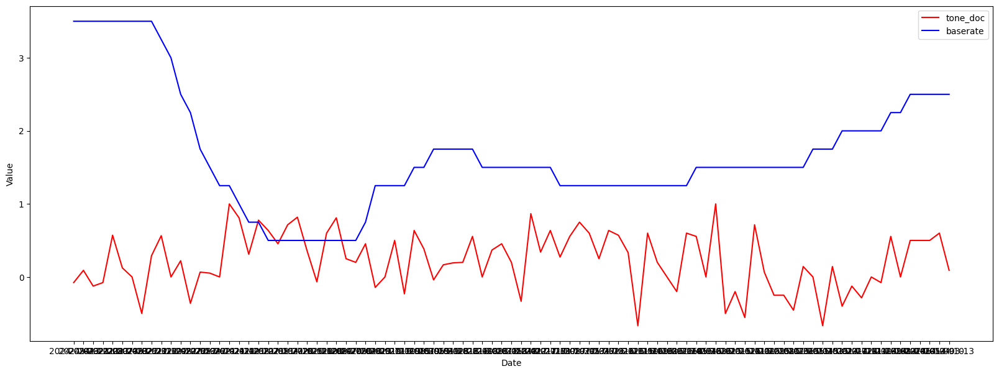

In [67]:
#시각화

import matplotlib.pyplot as plt

date = merge_df['date']
tone_Doc = merge_df['tone_doc'].apply(pd.Series)
Baserate = merge_df['baserate']

# 그래프 그리기
plt.figure(figsize=(20, 7))
plt.plot(date, tone_Doc, c='r', label='tone_doc')
plt.plot(date, Baserate, c='b', label='baserate')
plt.xlabel('Date')
plt.ylabel('Value')
plt.legend()
plt.show()